In [1]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import os
import cv2
import glob
%matplotlib inline

# Camera caliberation 
#### Trying to get 3d object points and its corresponding 2d image points required for caliberationg camera

In [2]:
def Caliberate_camera(path_to_imgs,chess_board = (6,9)):
        """
        This function caliberates the camera and gets the camera parameters
        @param path_to_imgs : path to chessboard images ie (camera_cal/calibration*.jpg)
        @param chess_board  : chess board size
        """
        # prepare 3d points of chess board, like (0,0,0), (1,0,0), (2,0,0) ....,
        objp = np.zeros((chess_board[0]*chess_board[1],3), np.float32)
        objp[:,:2] = np.mgrid[0:chess_board[1], 0:chess_board[0]].T.reshape(-1,2)

        # Arrays to store object points and image points from all the images.
        objpoints = [] # 3d points in real world space
        imgpoints = [] # 2d points in image plane.

        # Make a list of calibration images
        images = glob.glob(path_to_imgs)

        # Step through the list and search for chessboard corners
        for idx, fname in enumerate(images):
            img = mpimg.imread(fname)
            gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

            # Find the chessboard corners (2d points in the image)
            ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

            # If found, add object points(3d), image points(2d)
            if ret == True:
                objpoints.append(objp)       # append 3d points to objpoints
                imgpoints.append(corners)    # append 2d points found to imgpoints

                # Draw and display the corners
                cv2.drawChessboardCorners(img, (9,6), corners, ret)
                #write_name = 'corners_found'+str(idx)+'.jpg'
                #cv2.imwrite(write_name, img)
                plt.title("image with chessboard corners")
                plt.imshow(img)
                plt.show()

        img_size = (img.shape[1],img.shape[0])        
        # Do camera calibration given object points and image points
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)   
        
        return ret, mtx, dist, rvecs, tvecs

# Undistortion

In [3]:

def undistort_img(img,mtx,dist):
    """
    This function uses distortion coeficient to correct the distortion of the image
    returns colored undistorted image
    """
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    
    return undistorted

# Gradient Thresholding


In [4]:
def gradient_threshold(img, orient='x', thresh_min=0, thresh_max=255):
    """
    This function generates an output binary image
    Applying image gradient to the image in either direction or getting the magnitude of gradient
    @param img RGB image
    @param orient gradient orientation , default we take gradient in x-direction
    @param thresh_min,thresh_max minimum and maximum threshold to filter
    """
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    gradient = np.copy(gray)
    if orient == 'x':
        gradient = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize =  5)
    else:
        gradient = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize =  5)
    
    #  Take the absolute value of the derivative or gradient
    gardient_abs = np.absolute(gradient)
    
    #  Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*gardient_abs/np.max(gardient_abs))
    
    # Create a mask of 1's where the scaled gradient magnitude 
    binary_output = np.zeros_like(scaled_sobel)
    
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    return binary_output

# Magnitude thresholding

In [5]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F,1,0,ksize =sobel_kernel)
    sobel_y = cv2.Sobel(gray, cv2.CV_64F,0,1,ksize =sobel_kernel)
    # 3) Calculate the magnitude 
    magn = np.sqrt( (np.square(sobel_x) + np.square(sobel_y)) ) 
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*magn/np.max(magn))
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1    
    # 6) Return this mask as your binary_output image
    return binary_output

# Direction Thresholding

In [6]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    sobel_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(np.absolute(sobel_y),np.absolute(sobel_x))
    scaled_sobel = np.uint8(255*direction/np.max(direction))
    # 5) Create a binary mask where direction thresholds are met
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(direction >= thresh[0]) & (direction <= thresh[1])] = 1    
    # 6) Return this mask as your binary_output image

    return binary_output

# Threshold compination

In [7]:
def generate_threshold_compination(sobel_x,sobel_y,magnitude,direction):
    """
    This function generates a combination of all image thresholding techniques
    """
    combined = np.zeros_like(sobel_x)
    combined[((sobel_x == 1) & (sobel_y == 1)) | ((magnitude == 1) & (direction == 1))] = 1
    return combined

# Color Thresholding


In [8]:
def color_thresholding(img):
    """
    This function  Playing with color channels (HLS) and generate binary output
    """
    # convert image to HLS 
    hls = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
        
    h_channel = hls[:,:,0]    # preserve the color
    s_channel = hls[:,:,2]    # how much pixel is shaded (more robust)
    
    # as an enhancement to detect yellow lane lines 
    
    binary_h = np.zeros_like(h_channel)
    
    binary_h[(h_channel>=0)&(h_channel<=45)]=1
    
    binary_s = np.zeros_like(s_channel)
    
    binary_s[(s_channel>=100)&(s_channel<=255)]=1
    
    
    compined_colored = np.zeros_like(binary_s)
    
    compined_colored[(binary_h==1) & (binary_s ==1)] = 1
    return compined_colored
    
    

# Thresholding and Color compination

In [9]:
def generate_binary_compined(color,combined_threshold):
    """
    This function generate a binary combination between color thresholding and gradient thresholding
    """
    compined = np.zeros_like(color)
    
    compined[(color == 1) | (combined_threshold == 1)]=1
    
    return compined
    

# Prespective Transform 

In [10]:
def Bird_eye_view(image):
    """
    This function performs prespective transformation to an image to get bird's eye view with respect to image midpoint
    """
    mid_point = int(image.shape[1]//2)
    
    image_width = image.shape[1]
    image_height = image.shape[0]
    
    upper_left_pt  = [mid_point-90,465]
    upper_right_pt = [mid_point+90,465]
    lower_left_pt  = [mid_point-380,image.shape[0]]
    lower_right_pt = [mid_point+380,image.shape[0]]
    
    new_upper_left_pt  = [300,213]
    new_upper_right_pt = [1050,213]
    new_lower_left_pt  = [350,image.shape[0]]
    new_lower_right_pt = [933,image.shape[0]]
    

    src = np.float32([upper_left_pt,upper_right_pt,lower_left_pt,lower_right_pt])
    dst = np.float32([new_upper_left_pt,new_upper_right_pt,new_lower_left_pt,new_lower_right_pt])

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warp = cv2.warpPerspective(image, M, (image.shape[1], image.shape[0]))
    
    return warp , Minv

# Seprate left and right lane pixels

In [11]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) +midpoint

    # HYPERPARAMETES
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()

    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    #plt.title("Non Zero pixel locatons")
    #plt.scatter(nonzerox,nonzeroy)
    #plt.show()
    
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        
        # filter_value = (condition).nonzero()[0] 
        # (condition) is an array of true and falses 
        # filter_value holds the indecies of (condition) array @which the values are true(nonzero)
        filter_value_left = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]


        filter_value_right = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        

        good_left_inds = filter_value_left
        good_right_inds = filter_value_right
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


# Fitting Lane Lines

In [12]:
def fit_polynomial(binary_warped):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)
    
    # Fit a second order polynomial to each using `np.polyfit`
    left_fit  = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    return out_img , left_fitx , right_fitx ,ploty

# Measuring curvature

In [31]:
def curvature_estimation(left_fit,right_fit,ploty):
    """
    This function calculates the radius of curvature in pixels
    applies this equation (1+(2Ay+B)^2)^(3/2) /|2A|
    """
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    
    # using the ploty and fit a new line which maps pixels to real-world
    # using left_fit and right_fit pixels and map them to real-world
    left_fit_cr  = np.polyfit(ploty*ym_per_pix, left_fit*xm_per_pix, 2)   # real-world fitted line
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fit*xm_per_pix, 2)  # real-world fitted line
    
    #####  Implement the calculation of R_curve (radius of curvature) #####
    y_dash_left = 2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1] 
    y_double_dash_left = np.absolute(2*left_fit_cr[0])
    
    y_dash_right = 2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1] 
    y_double_dash_right = np.absolute(2*right_fit_cr[0])
    
    R2 = lambda f_dash , f_double_dash :  ((1+(f_dash**2))**1.5) / (f_double_dash)
    left_curverad = R2(y_dash_left,y_double_dash_left)  ## Implement the calculation of the left line here
    right_curverad = R2(y_dash_right,y_double_dash_right)  ## Implement the calculation of the right line here
    
    # convert them to KM 
    left_curverad/=1000
    right_curverad/=1000
    #print(left_curverad)
    #print(right_curverad)
    
    return left_curverad, right_curverad

# Car position


In [48]:
def position_estimation(warped,left_fit,right_fit):
    """
    This function estimates the car position with respect to center
    """

    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    actual_center = warped.shape[1]//2
    
    estimated_center = (left_fit[-1] + right_fit[-1])/2
   
    # calculate offset from actual center and mapping from pixel to real-world
    offset = ( actual_center- estimated_center) * xm_per_pix
    
    #print(offset)
    
    return offset

# Drawing

In [58]:
def draw(undist,warped,left_fitx,right_fitx,ploty,Minv,left_curverad,right_curverad,offset):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    cv2.putText(result,'Left Curve Radius  [Km]: '+str(left_curverad)[:7],(40,70), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1.6, (255,255,255),2,cv2.LINE_AA)
    cv2.putText(result,'Right Curve Radius [Km]: '+str(right_curverad)[:7],(40,150), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1.6, (255,255,255),2,cv2.LINE_AA)
    if offset < 0:
        cv2.putText(result,'Center Offset is : '+str(abs(offset))[:7]+" [m] left ",(40,220), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1.6,(255,255,255),2,cv2.LINE_AA)
    else:
        cv2.putText(result,'Center Offset is : '+str(abs(offset))[:7]+" [m] right",(40,220), cv2.FONT_HERSHEY_COMPLEX_SMALL, 1.6,(255,255,255),2,cv2.LINE_AA)
        
    
    
    
    return result


# Unit Testing of each function

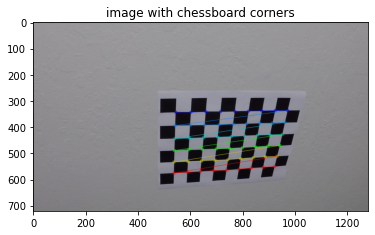

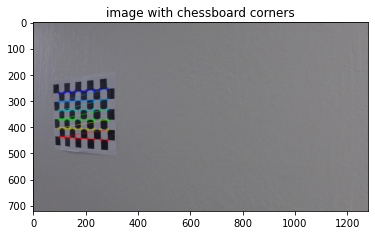

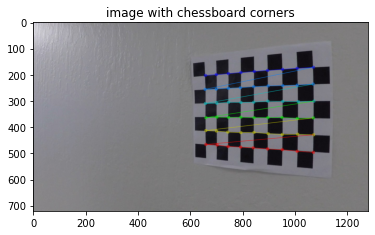

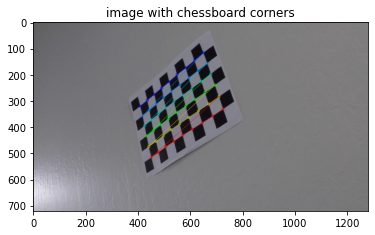

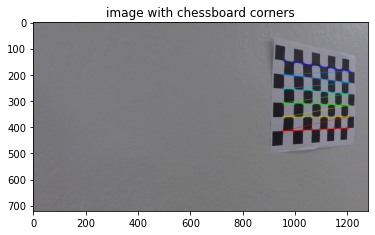

...

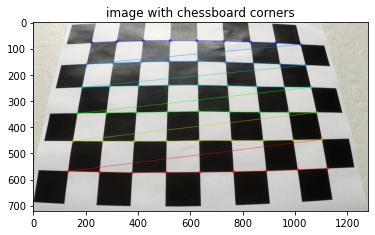

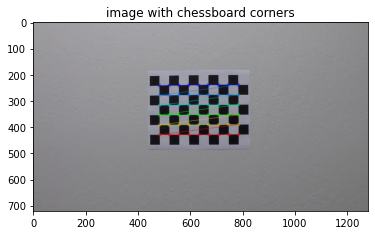

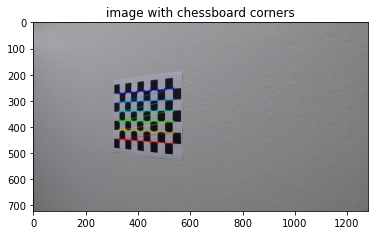

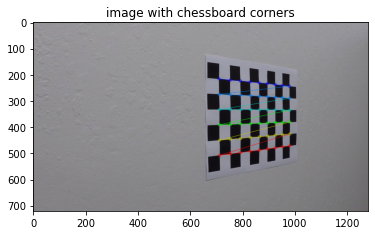

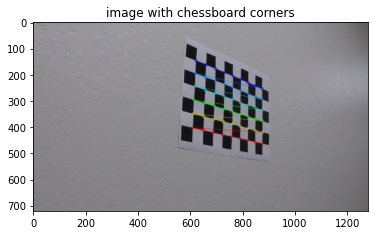

In [16]:
# Caliberate camera first
ret, mtx, dist, rvecs, tvecs = Caliberate_camera('camera_cal/calibration*.jpg')

In [17]:
# this will be used for testing purposes
images = glob.glob("test_images/*.jpg")

## Test undistortion

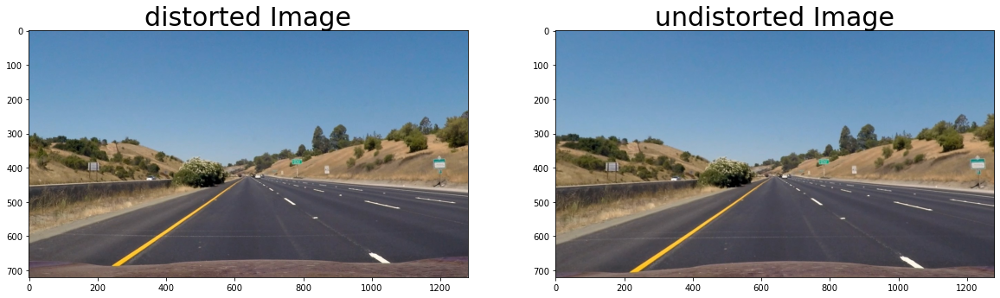

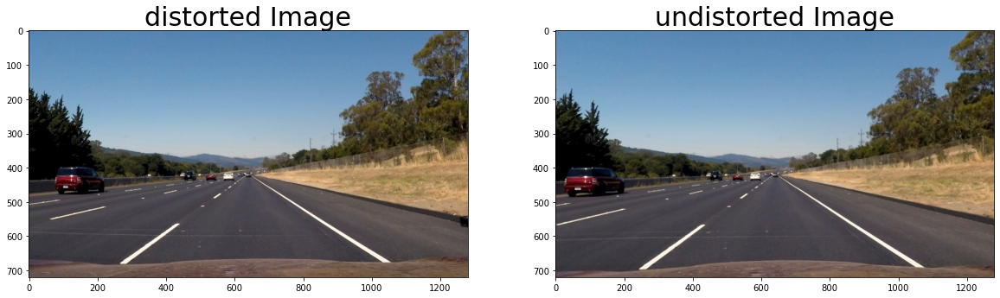

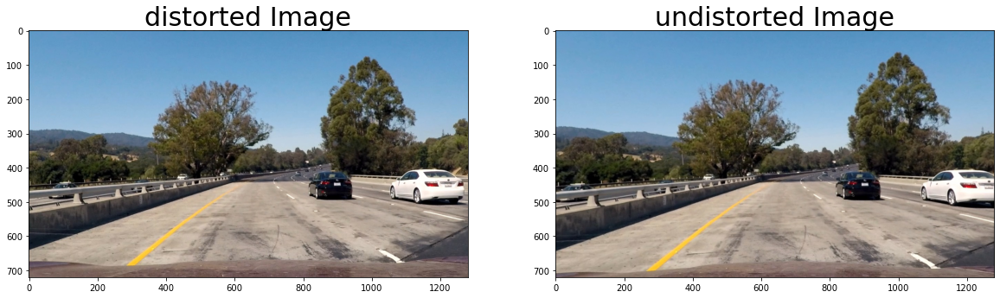

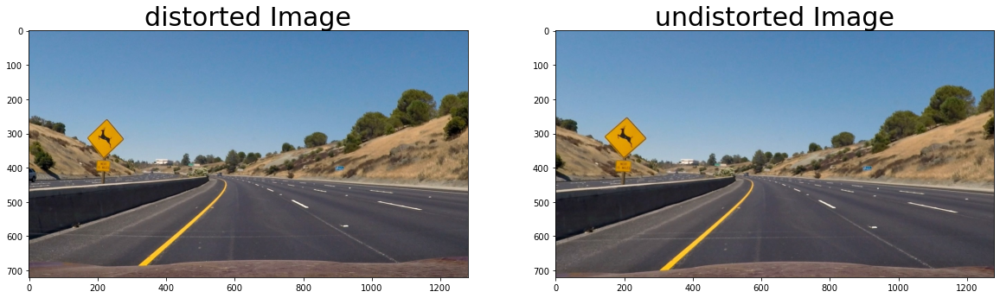

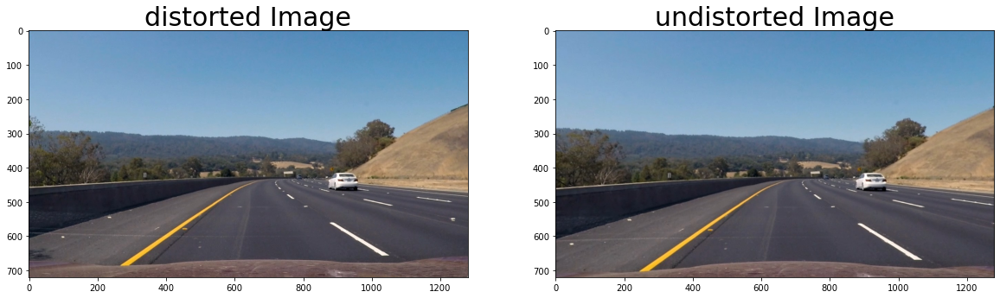

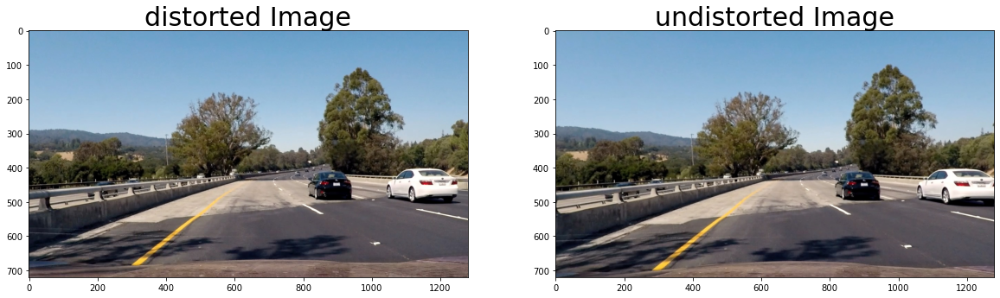

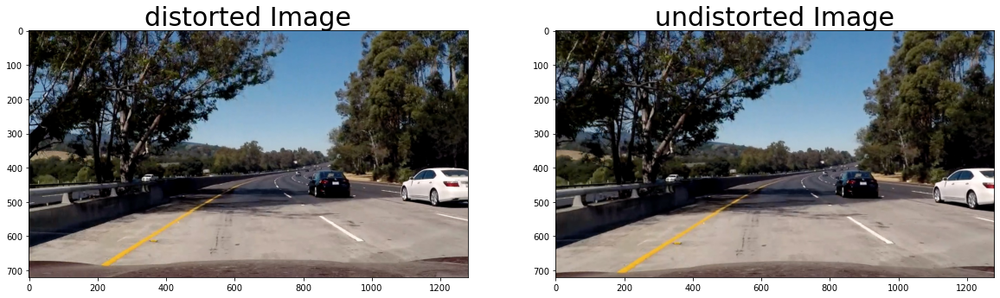

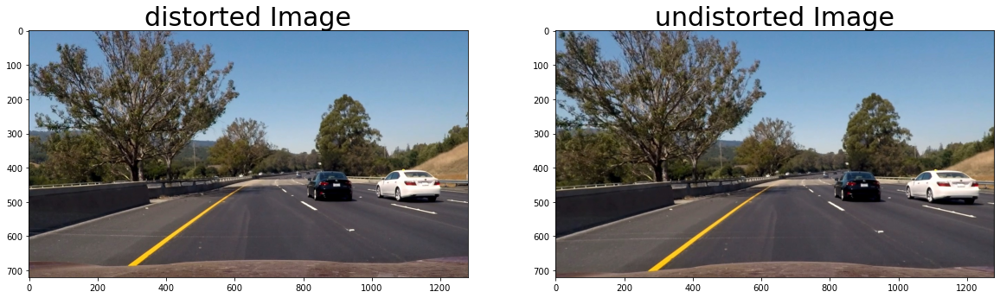

In [18]:
undistorted_imgs = []
for img_path in images:
    distorted =  mpimg.imread(img_path)
    undistorted = undistort_img(distorted,mtx,dist)
    undistorted_imgs.append(undistorted)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(distorted)
    ax1.set_title('distorted Image', fontsize=30)
    ax2.imshow(undistorted)
    ax2.set_title('undistorted Image', fontsize=30) 
    
    
# saving images on hard for review
plt.savefig('output_images/undistorted_sample_output.jpg')    
    

## Test gradient_threshold

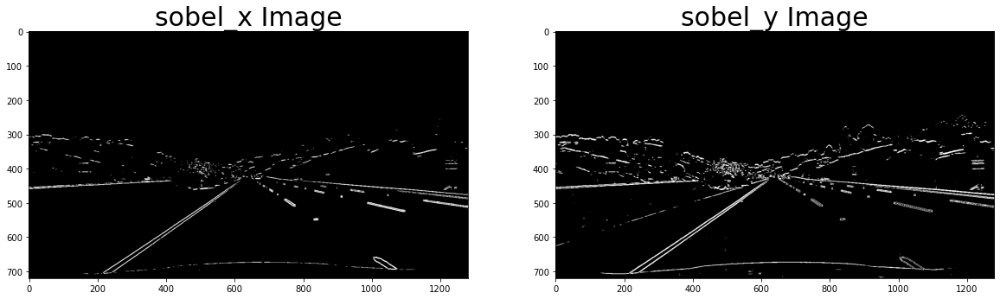

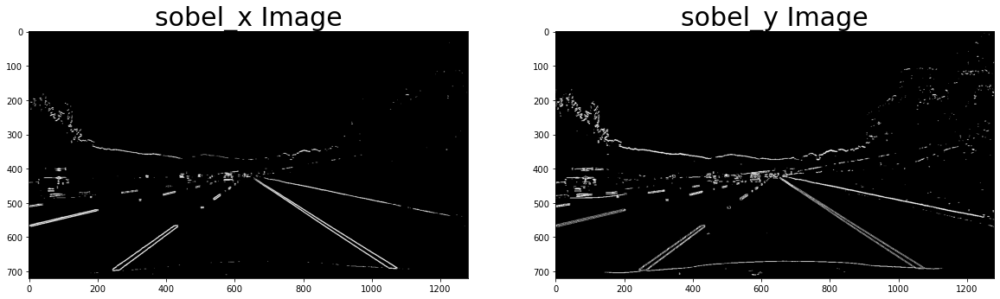

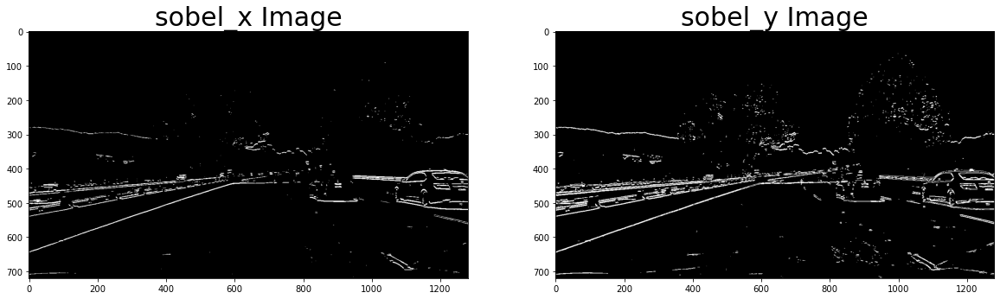

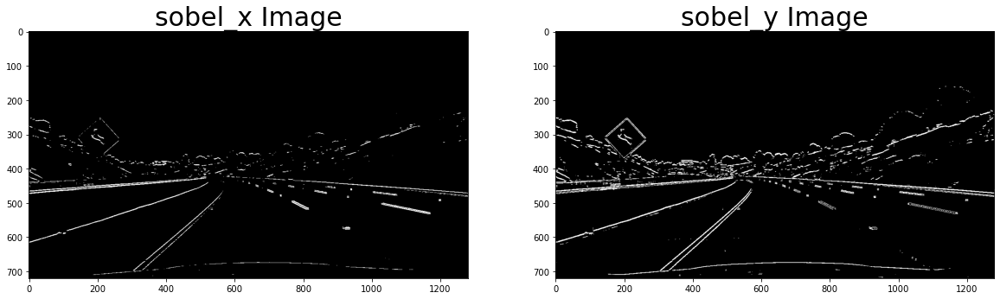

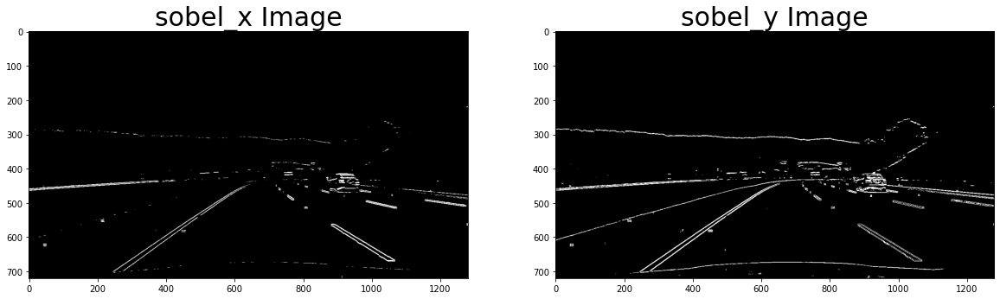

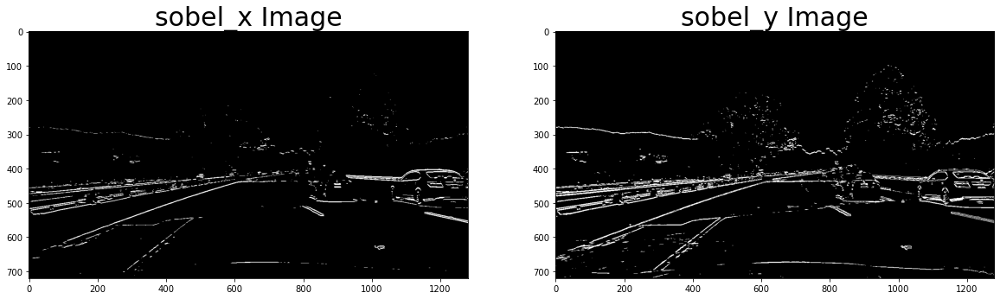

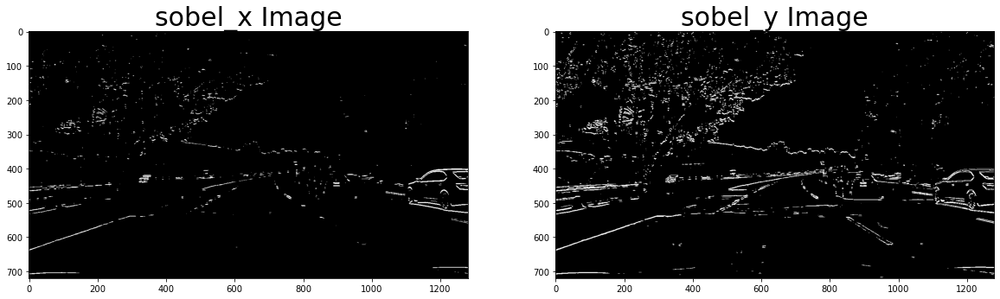

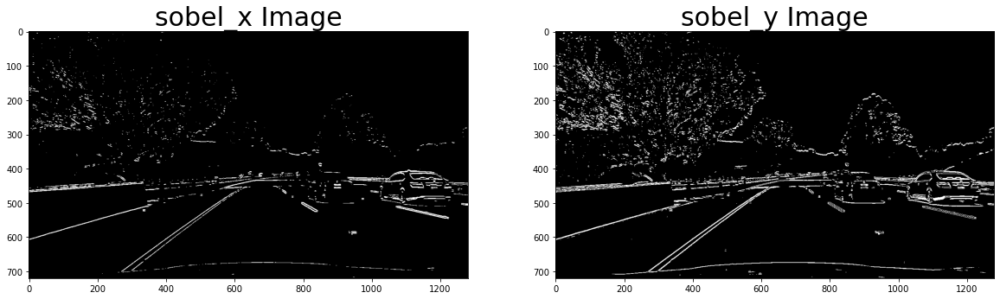

In [19]:
sobel_x_imgs = []
sobel_y_imgs = []
for undistorted in undistorted_imgs:
    
    sobel_x = gradient_threshold(undistorted,20,75)
    sobel_y = gradient_threshold(undistorted,'y',50,150)
    sobel_x_imgs.append(sobel_x)
    sobel_y_imgs.append(sobel_y)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(sobel_x,cmap='gray')
    ax1.set_title('sobel_x Image', fontsize=30)
    ax2.imshow(sobel_y,cmap='gray')
    ax2.set_title('sobel_y Image', fontsize=30) 
    

# saving images on hard for review
plt.savefig('output_images/sobelX_sobely_sample_output.jpg')        

## Test magnitude thresholding


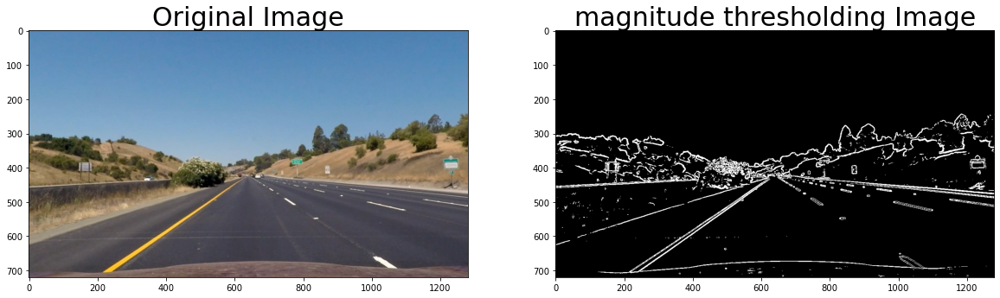

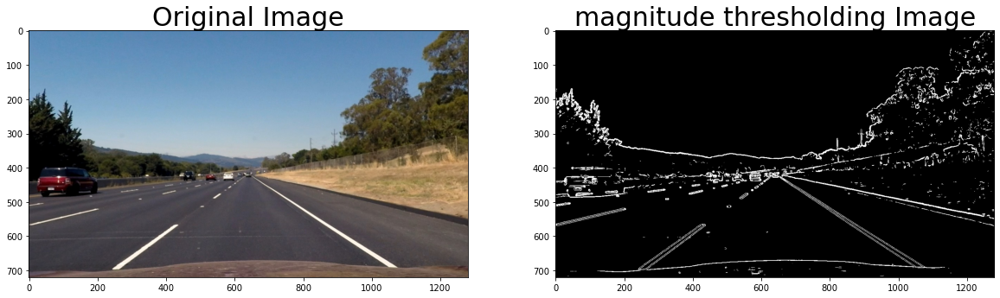

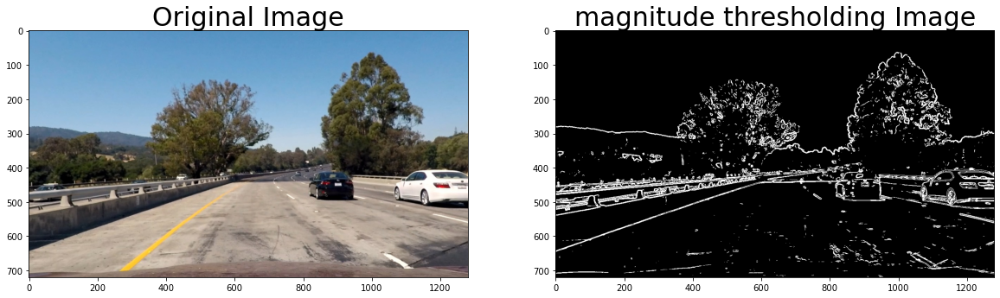

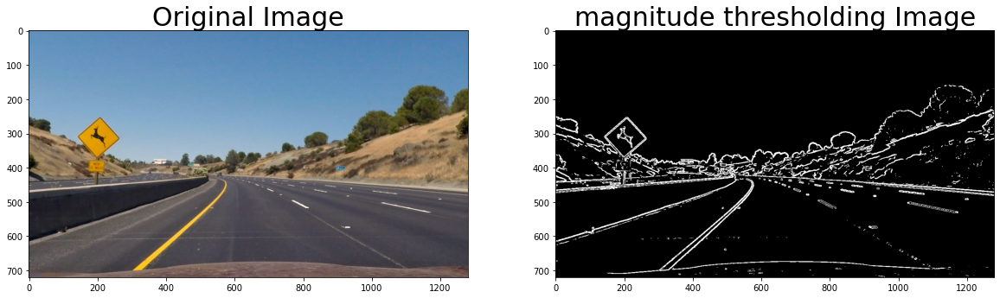

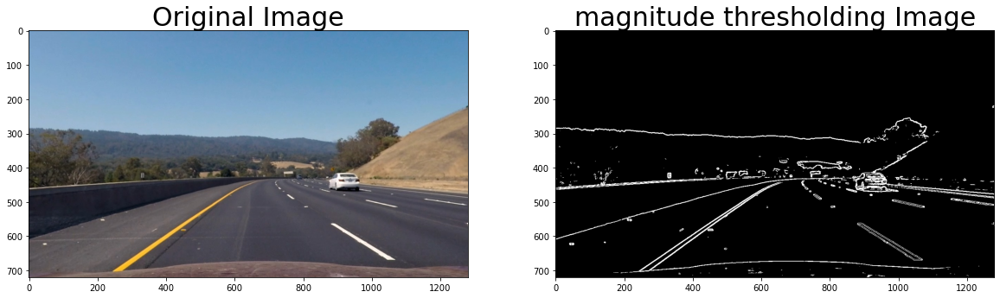

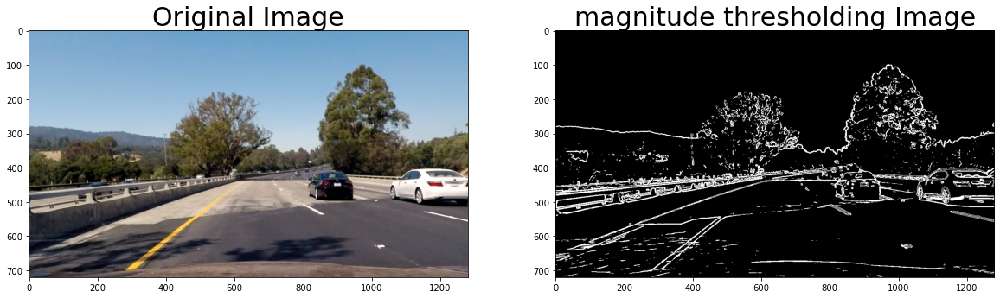

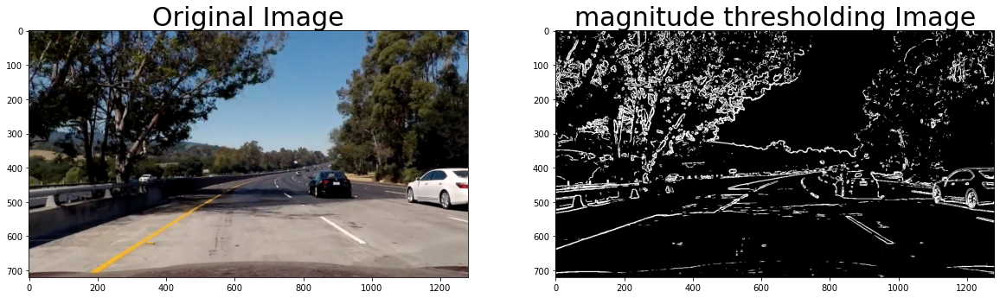

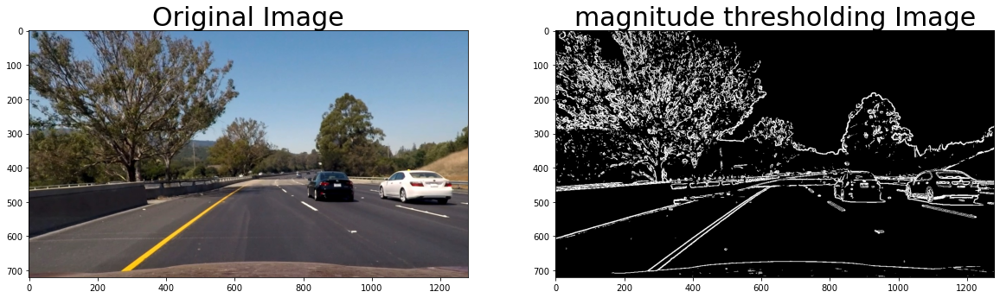

In [20]:
sobel_mag_imgs=[]
for undistorted in undistorted_imgs:

    sobel_mag = mag_thresh(undistorted,sobel_kernel=5, mag_thresh=(40, 150))
    sobel_mag_imgs.append(sobel_mag)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undistorted)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(sobel_mag,cmap='gray')
    ax2.set_title('magnitude thresholding Image', fontsize=30) 
    
# saving images on hard for review
plt.savefig('output_images/magnitude_thresholding_sample_output.jpg')        

## Test Direction Thresholding

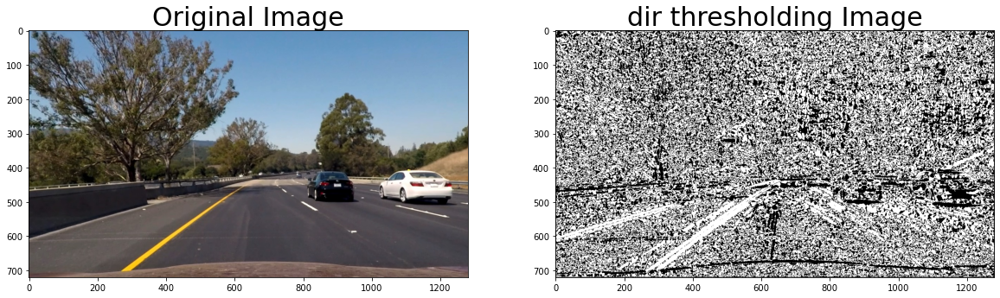

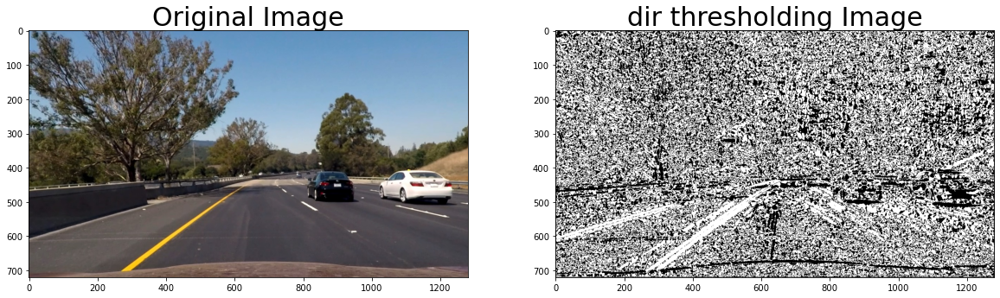

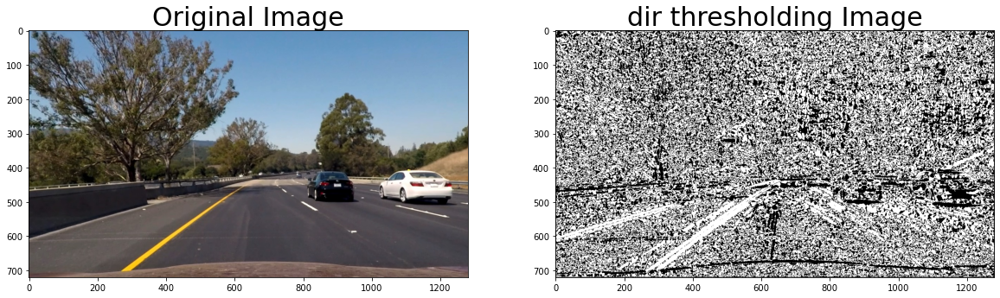

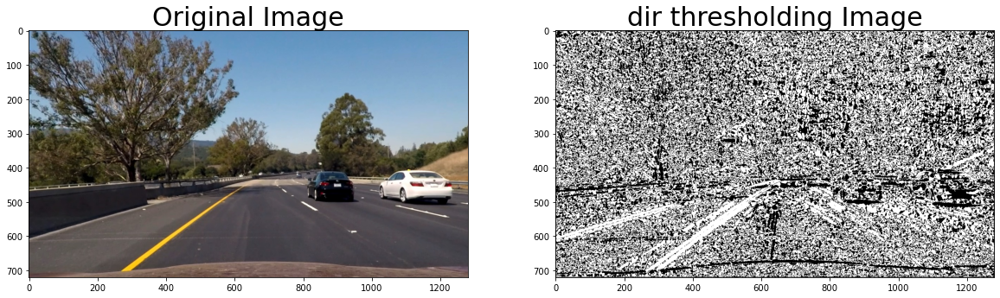

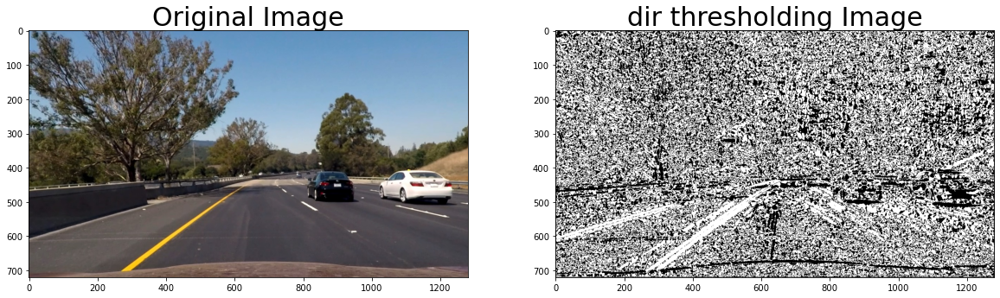

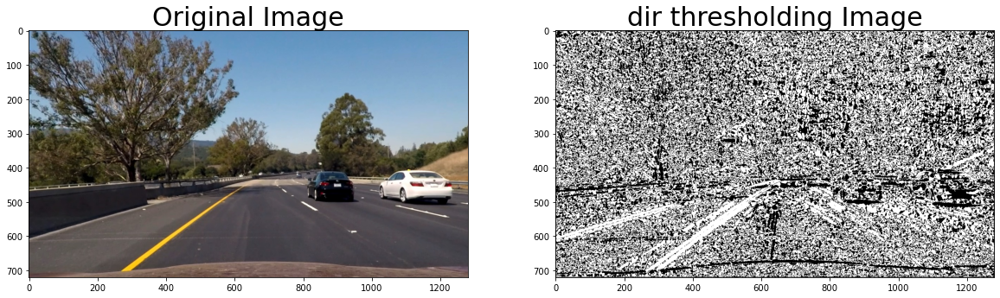

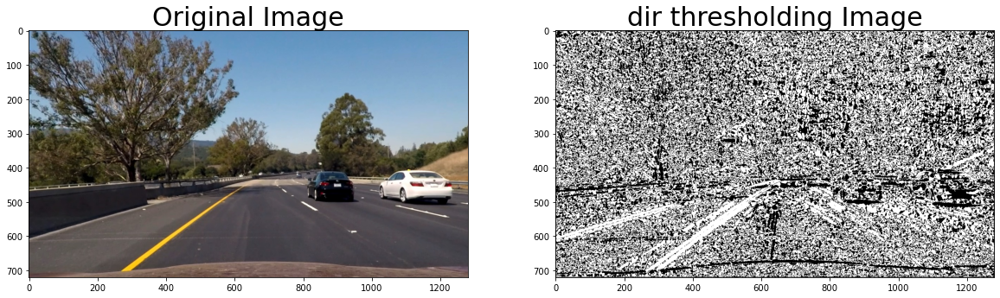

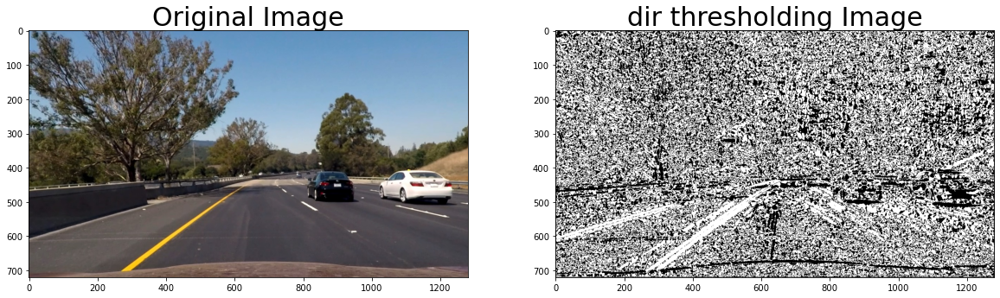

In [21]:
sobel_dir_imgs=[]
for undistorted in undistorted_imgs:
    distorted =  mpimg.imread(img_path)
    undistorted = undistort_img(distorted,mtx,dist)
    
    sobel_dir = dir_threshold(undistorted, sobel_kernel=15, thresh=(0.5, 1.3962))
    sobel_dir_imgs.append(sobel_dir)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undistorted)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(sobel_dir,cmap='gray')
    ax2.set_title('dir thresholding Image', fontsize=30) 
    
# saving images on hard for review
plt.savefig('output_images/direction_thresholding_sample_output.jpg')        

## Test threshold compination images

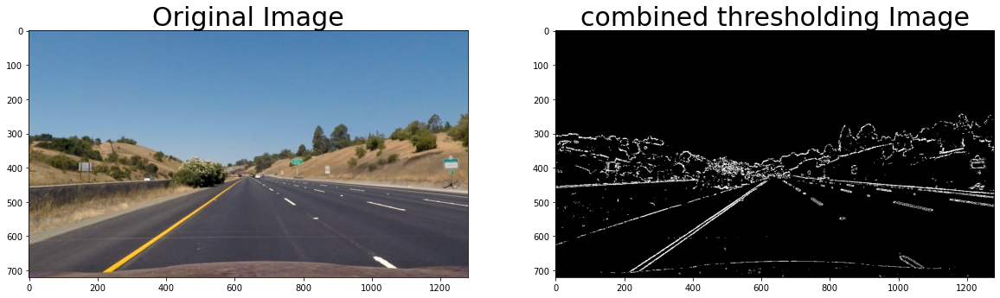

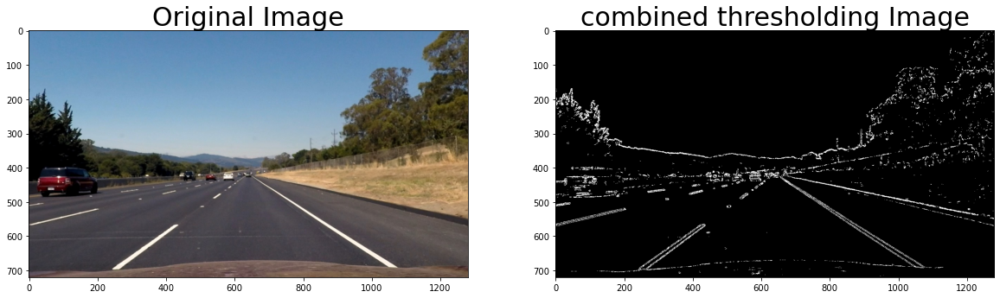

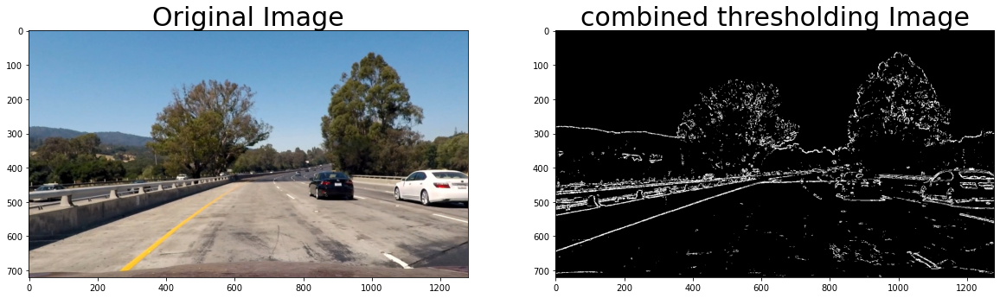

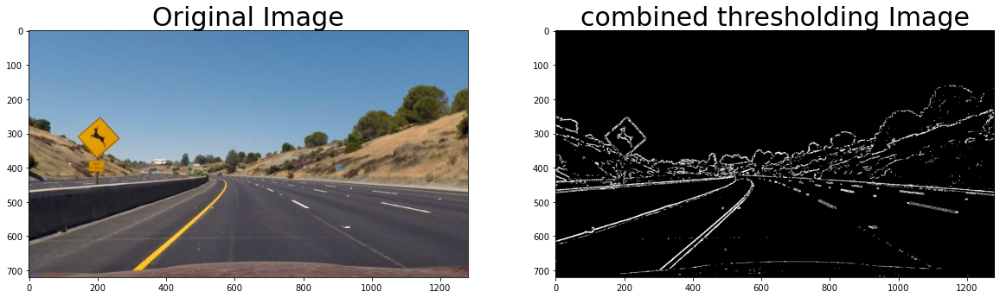

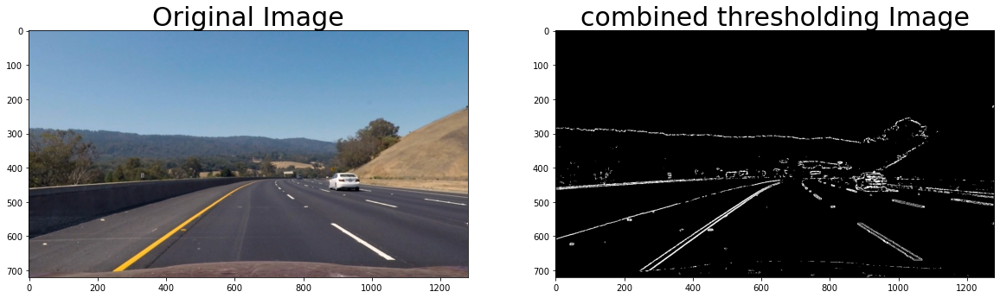

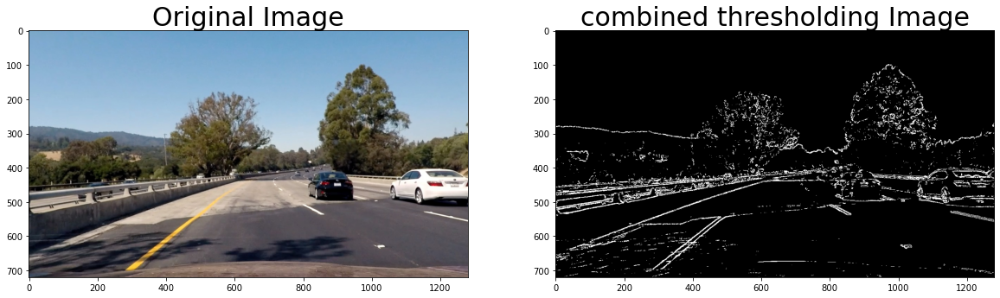

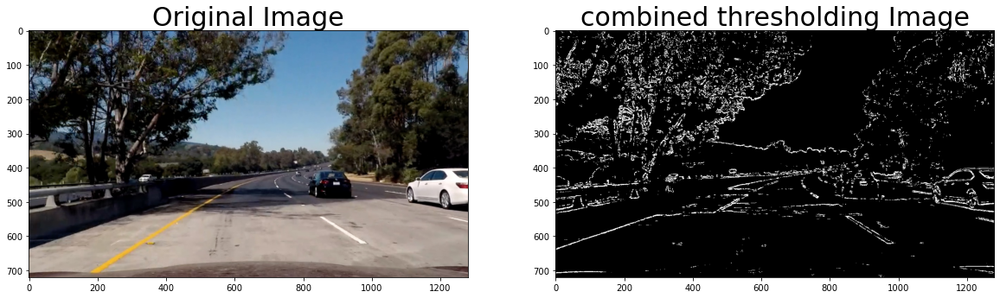

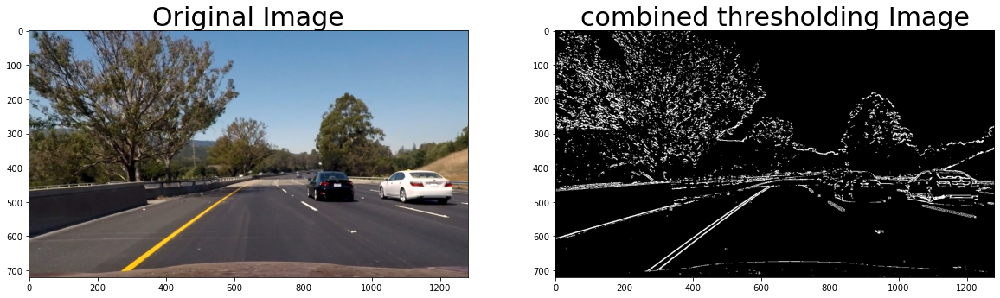

In [22]:
for undistorted,sobel_x,sobel_y,sobel_mag,sobel_dir in zip(undistorted_imgs,sobel_x_imgs,sobel_y_imgs,sobel_mag_imgs,sobel_dir_imgs):
    combined = generate_threshold_compination(sobel_x,sobel_y,sobel_mag,sobel_dir)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undistorted)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(combined,cmap='gray')
    ax2.set_title('combined thresholding Image', fontsize=30) 
    
    # saving images on hard for review
plt.savefig('output_images/Threshold_compination_sample_output.jpg')    

## Test Color thresholding


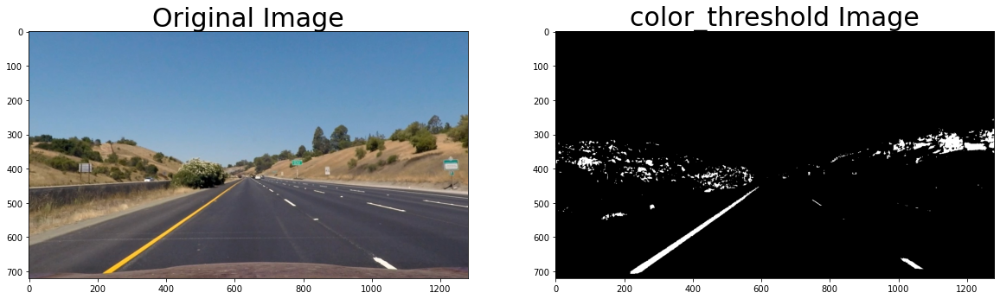

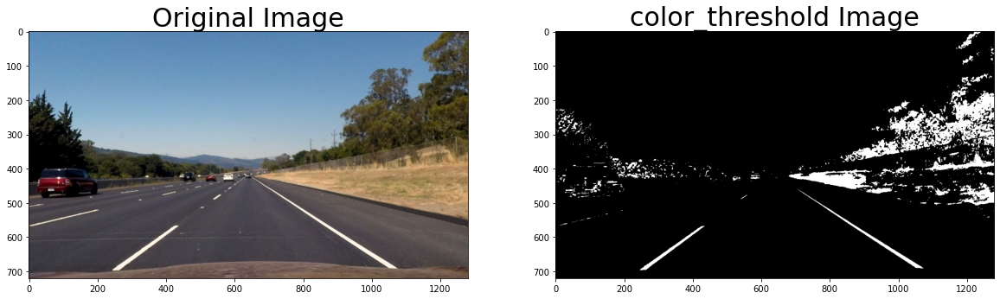

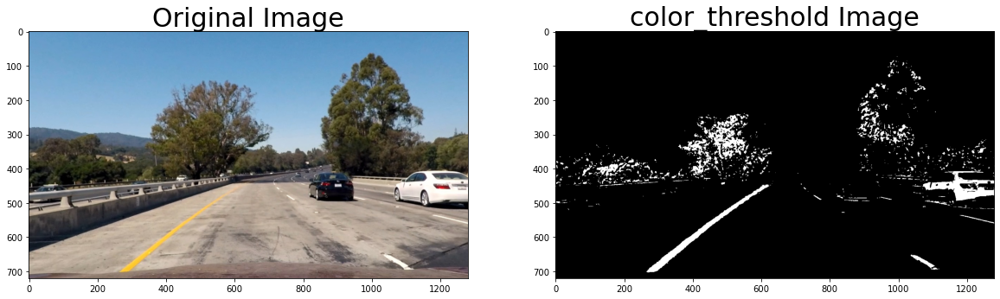

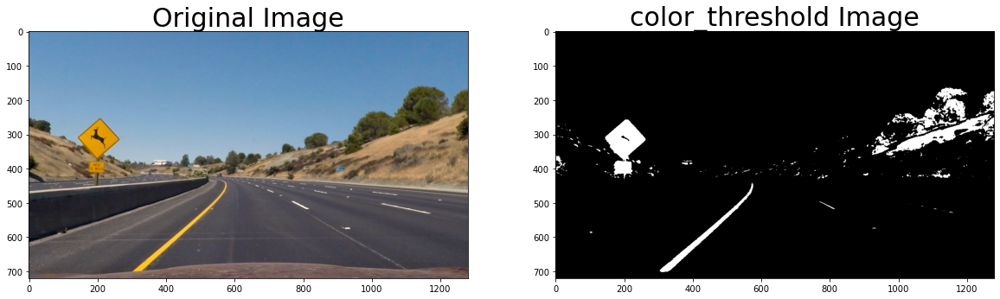

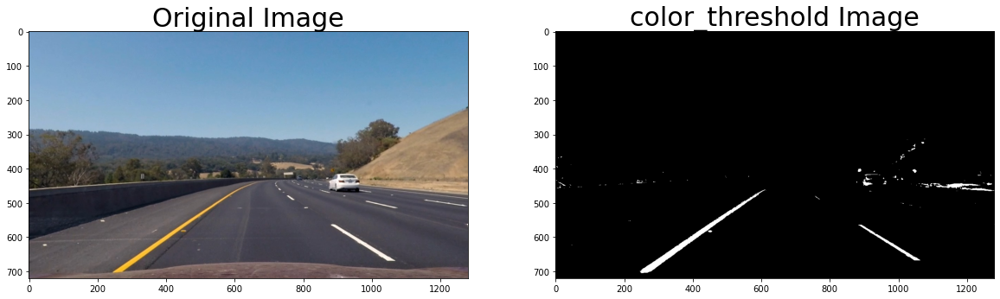

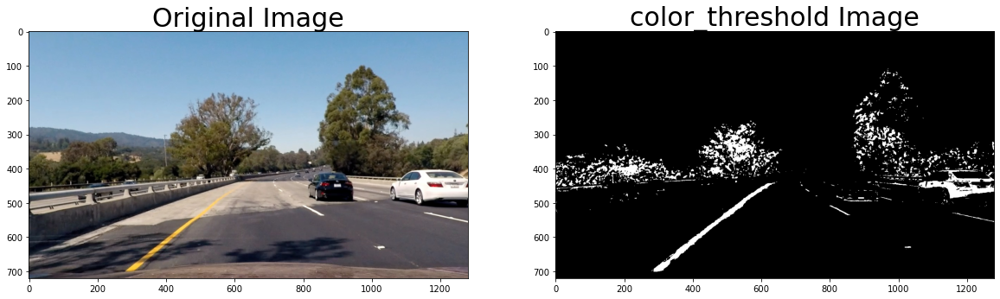

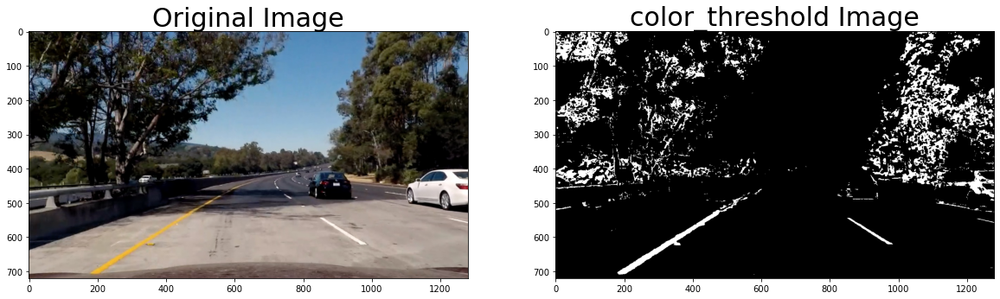

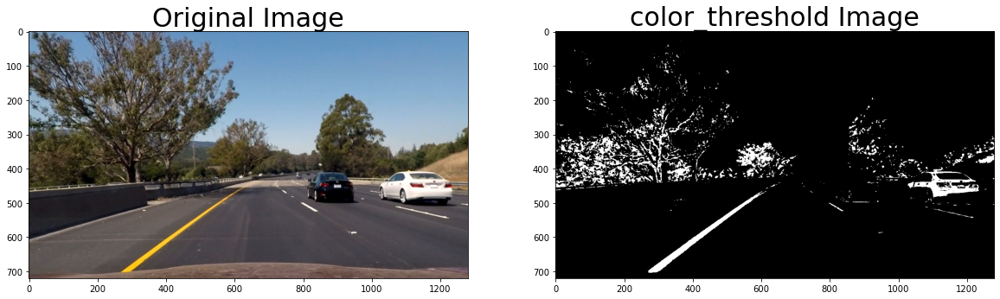

In [23]:
for undistorted in undistorted_imgs:

    color_threshold = color_thresholding(undistorted)
    
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undistorted)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(color_threshold,cmap='gray')
    ax2.set_title('color_threshold Image', fontsize=30) 
    
# saving images on hard for review
plt.savefig('output_images/Color_thresholding_sample_output.jpg')        

## Test compination between color thresholding and gradient thresholding

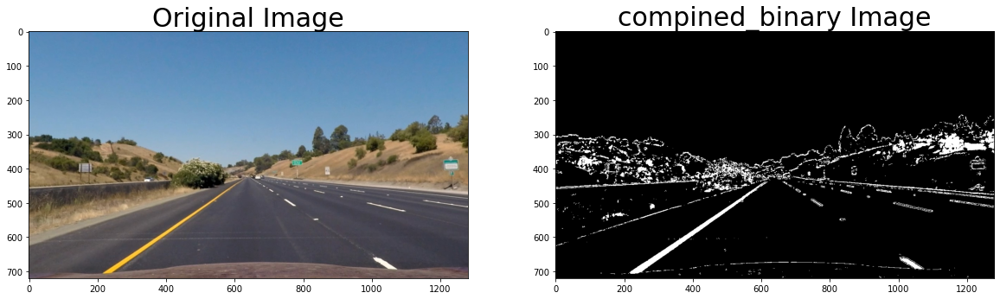

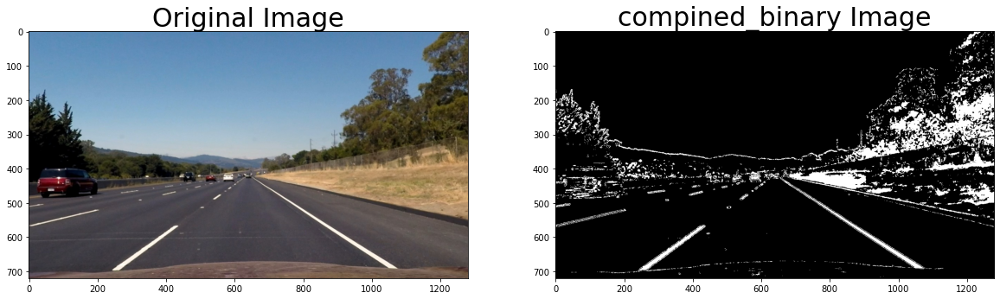

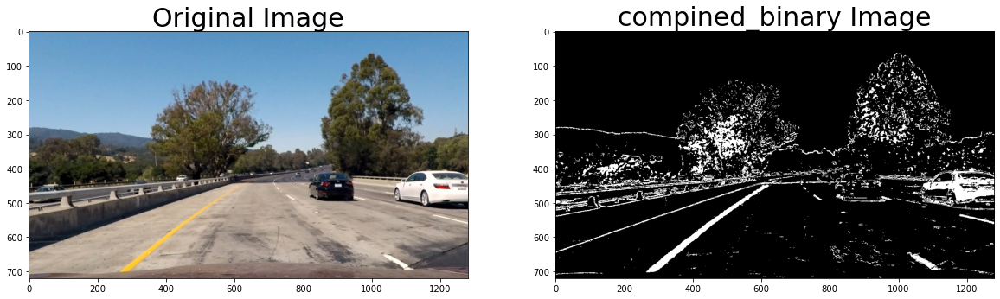

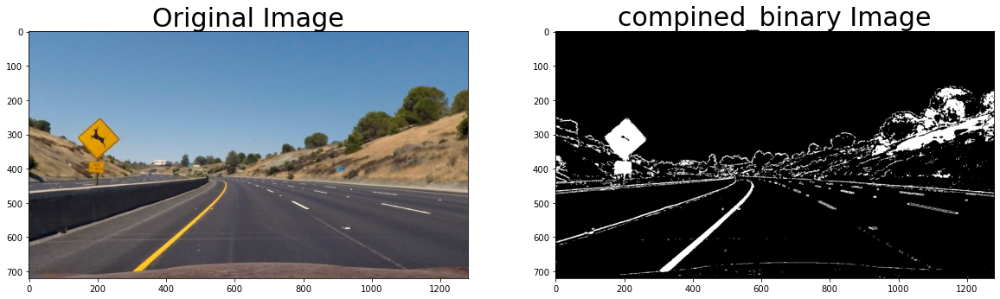

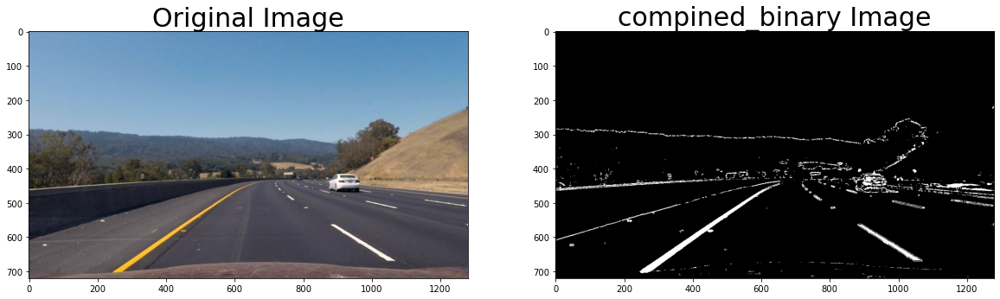

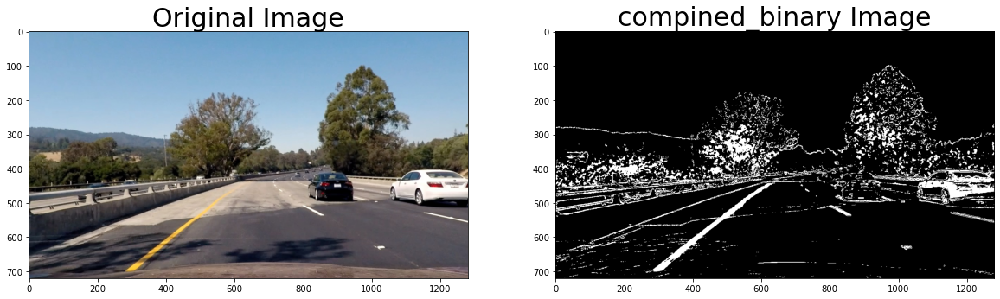

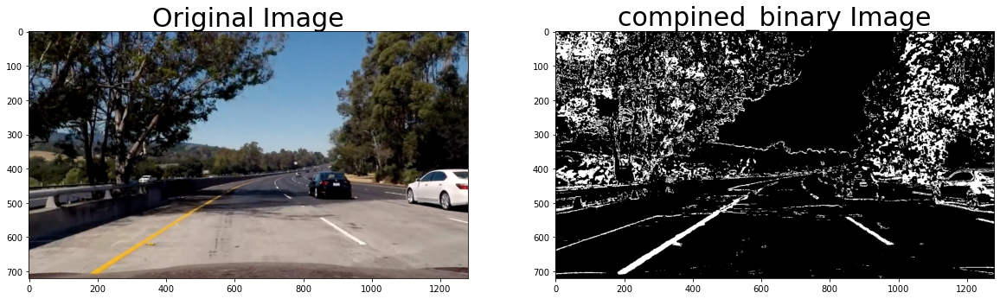

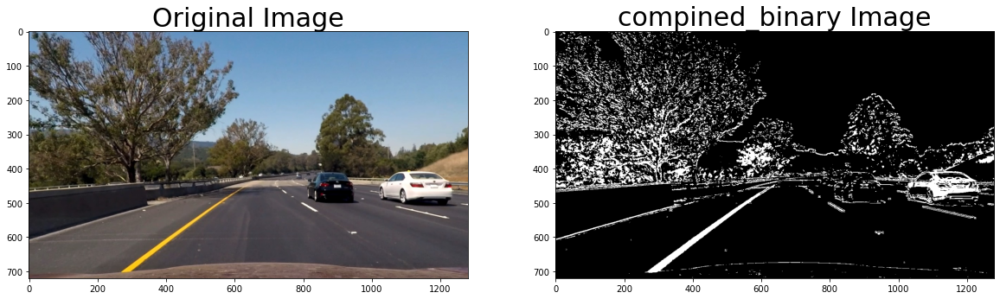

In [24]:
compined_binary_imgs = []
for undistorted,sobel_x,sobel_y,sobel_mag,sobel_dir in zip(undistorted_imgs,sobel_x_imgs,sobel_y_imgs,sobel_mag_imgs,sobel_dir_imgs):

    color_threshold = color_thresholding(undistorted)

    combined = generate_threshold_compination(sobel_x,sobel_y,sobel_mag,sobel_dir)
    compined_binary = generate_binary_compined(color_threshold,combined)
    compined_binary_imgs.append(compined_binary)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(undistorted)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(compined_binary,cmap='gray')
    ax2.set_title('compined_binary Image', fontsize=30) 
    
# saving images on hard for review
plt.savefig('output_images/Color_gradient_compination_sample_output.jpg')    

## Test Bird's eye view

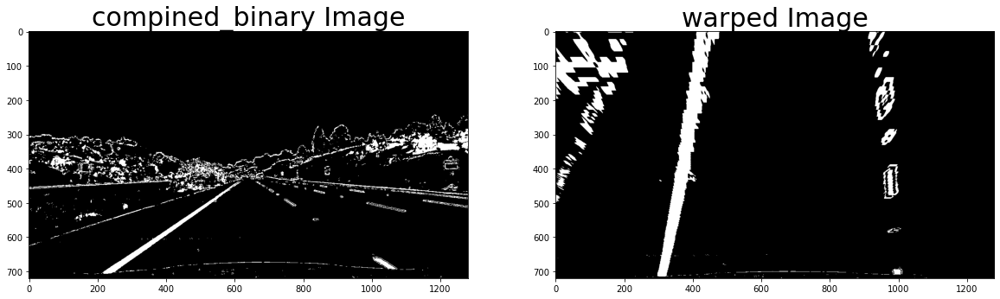

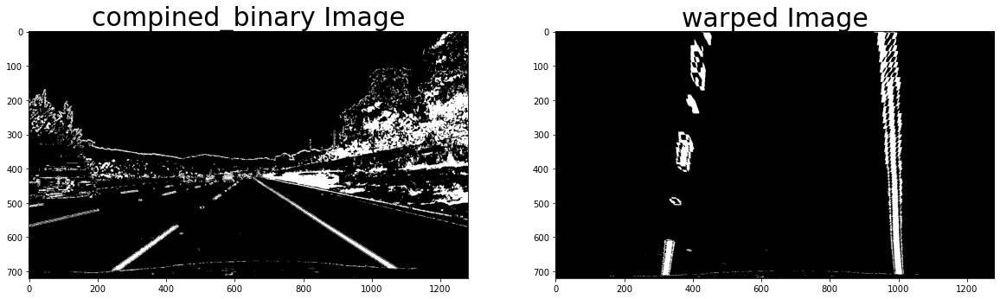

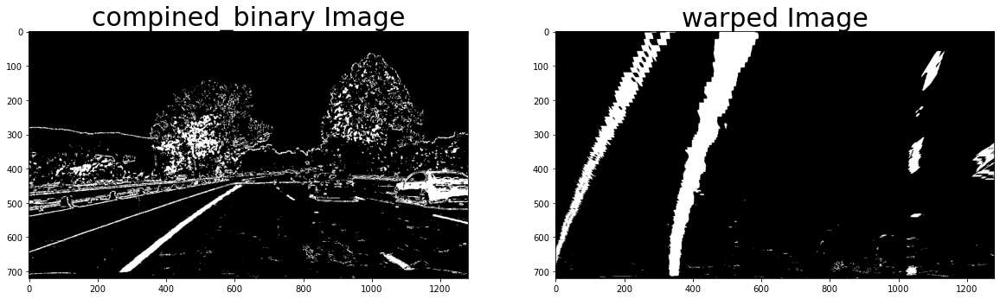

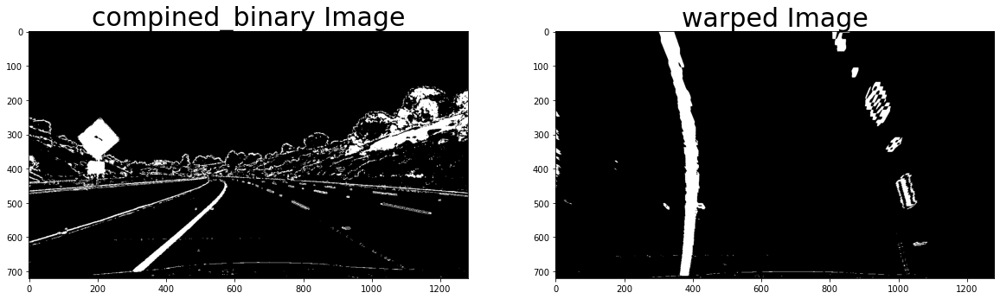

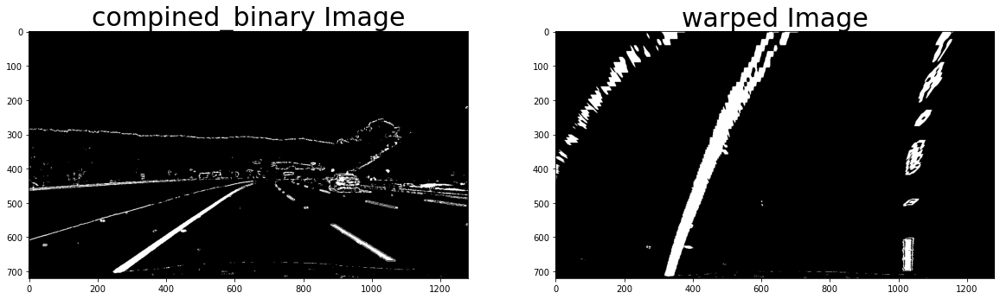

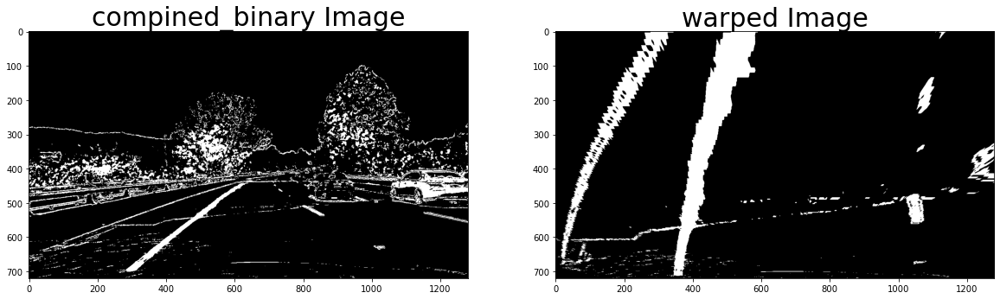

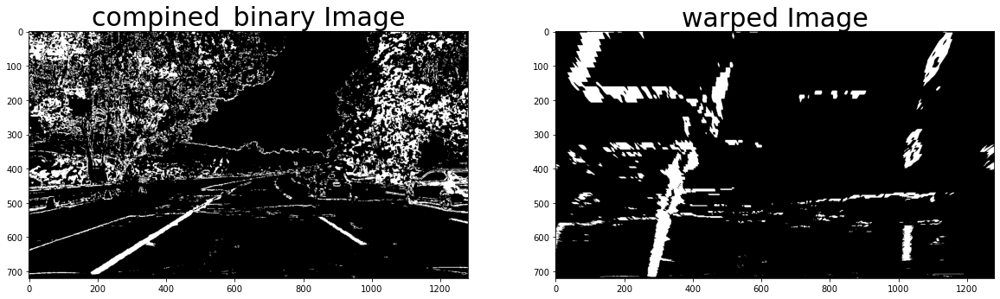

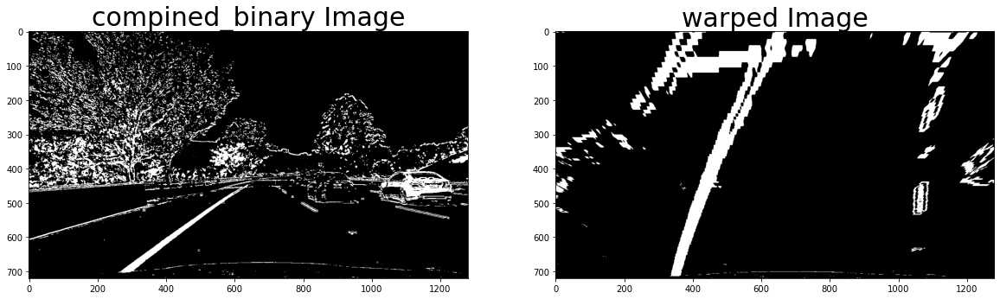

In [26]:
warped_imgs = []
for compined_binary in compined_binary_imgs:
    warped , Minv = Bird_eye_view(compined_binary)
    warped_imgs.append(warped)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(compined_binary,cmap='gray')
    ax1.set_title('compined_binary Image', fontsize=30)
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('warped Image', fontsize=30) 
    
# saving images on hard for review
plt.savefig('output_images/Birds_Eye_View_sample_output.jpg')    

## Test polynomial fitting

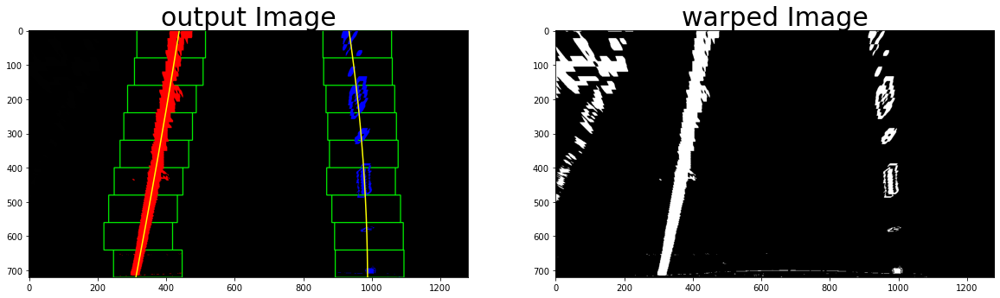

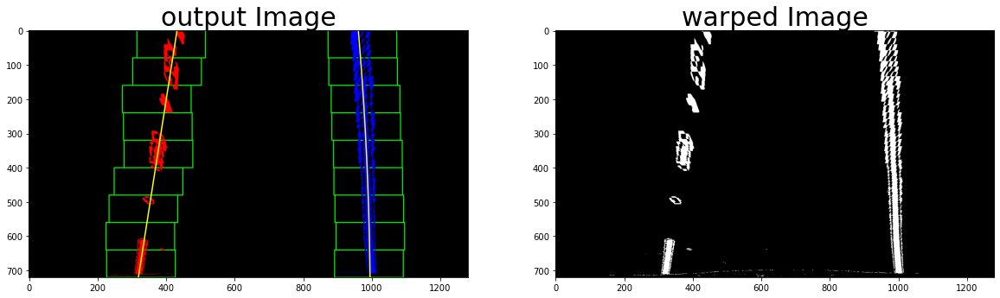

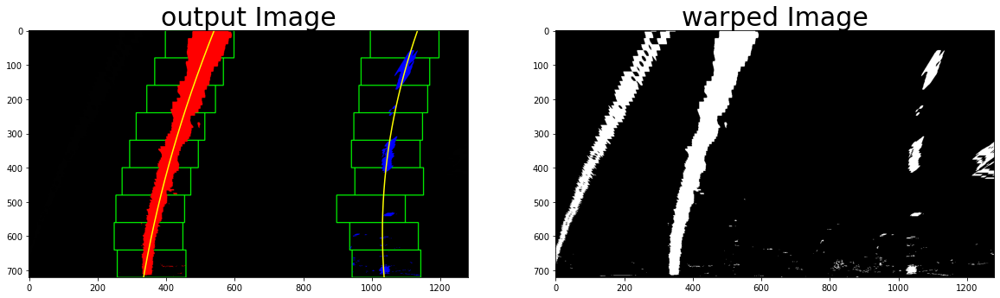

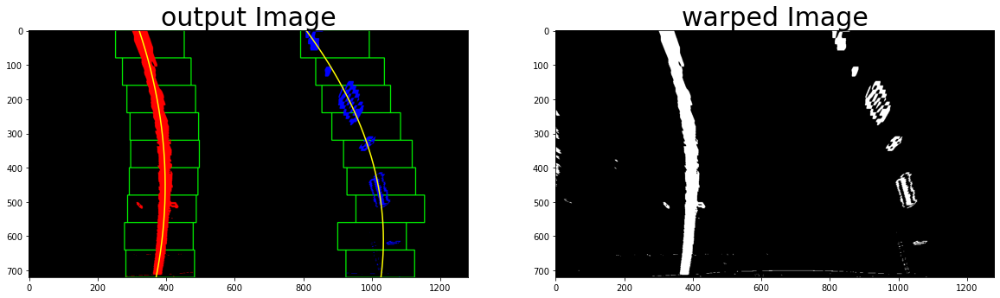

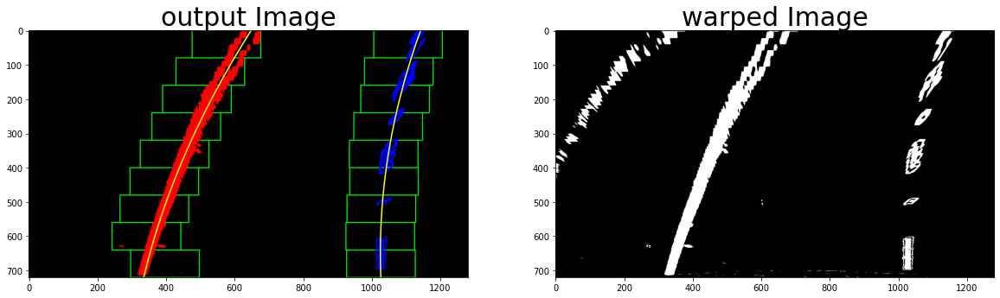

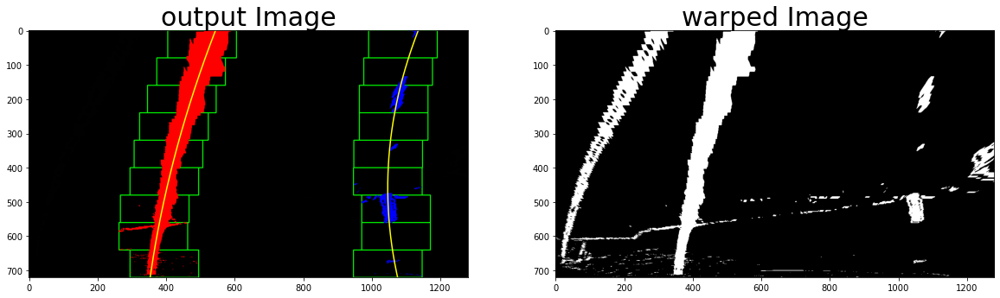

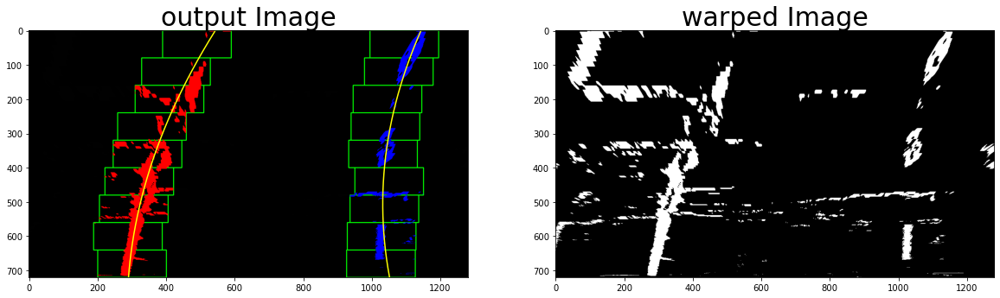

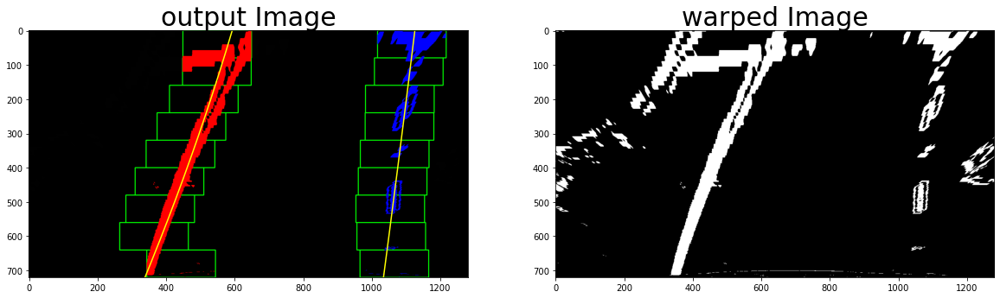

In [27]:
left_fitx_data = []
right_fitx_data = []
ploty_data = []
for warped in warped_imgs:

    out_img ,left_fitx , right_fitx,ploty= fit_polynomial(warped)
    
    left_fitx_data.append(left_fitx)
    right_fitx_data.append(right_fitx)
    ploty_data.append(ploty)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(out_img)
    ax1.set_title('output Image', fontsize=30)
    ax1.plot(left_fitx, ploty, color='yellow')
    ax1.plot(right_fitx, ploty, color='yellow')    
    
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('warped Image', fontsize=30) 



# saving images on hard for review
plt.savefig('output_images/Polynomial_Fitting_sample_output.png')        

## Test Curvature estimation


In [52]:

for left_fitx,right_fitx,ploty in zip(left_fitx_data,right_fitx_data,ploty_data):
    left_curverad, right_curverad = curvature_estimation(left_fitx,right_fitx,ploty)
     
    print("Left_curvature : ",left_curverad)
    print("Right_curvature : ",right_curverad)

Left_curvature :  7.849318498294583
Right_curvature :  1.6830279559449004
Left_curvature :  208.02228497614834
Right_curvature :  3.190693280437585
Left_curvature :  1.0565156127218849
Right_curvature :  0.5592335104571657
Left_curvature :  0.4455209598455168
Right_curvature :  0.2739218013924479
Left_curvature :  0.6016754152059892
Right_curvature :  0.5925317613251639
Left_curvature :  0.9736847153009578
Right_curvature :  0.39056366725258923
Left_curvature :  0.4300561910869177
Right_curvature :  0.3784720138839807
Left_curvature :  2.097959208254583
Right_curvature :  24.0445342693891


## Test Offset estimation

In [53]:

for warped,left_fitx,right_fitx in zip(warped_imgs,left_fitx_data,right_fitx_data):
    offset = position_estimation(warped,left_fitx,right_fitx)
    print(offset)

-0.05179577332747207
-0.09002949398642777
-0.23849247380539007
-0.31138918083223327
-0.21440585067766016
-0.3924660130455601
-0.16337879153123439
-0.24572581922580358


## Testing the whole pipeline on test images

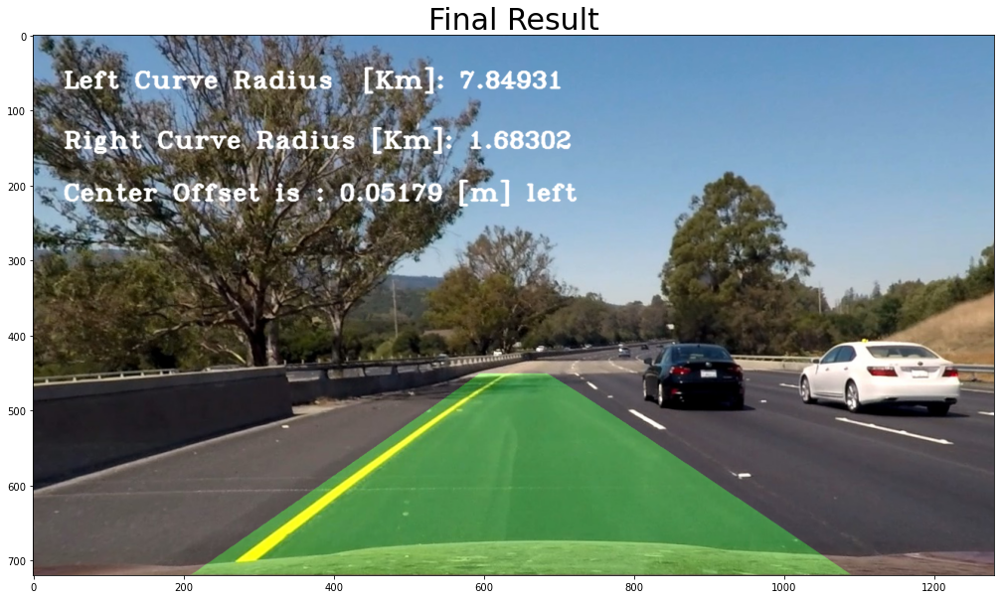

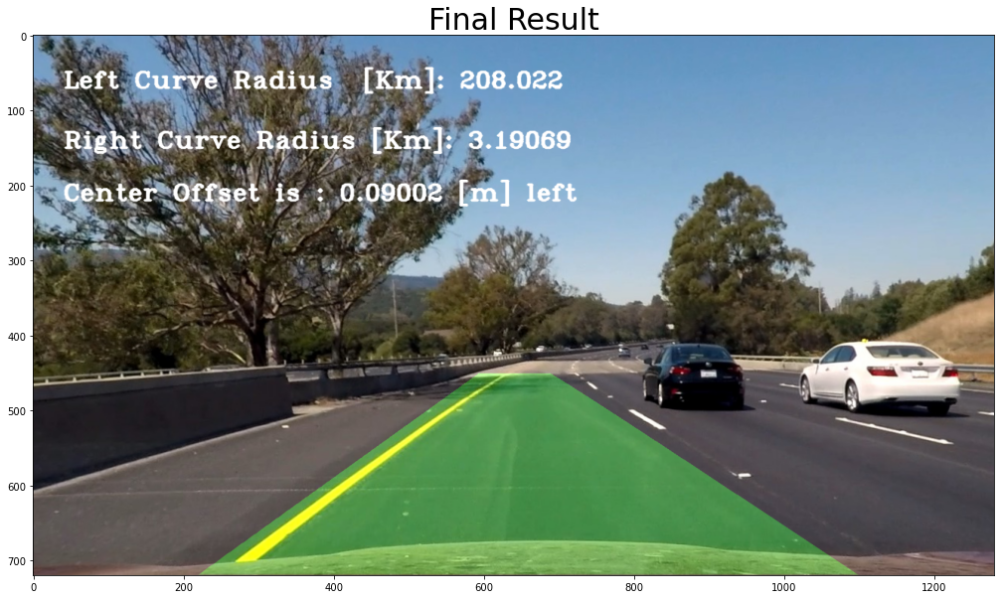

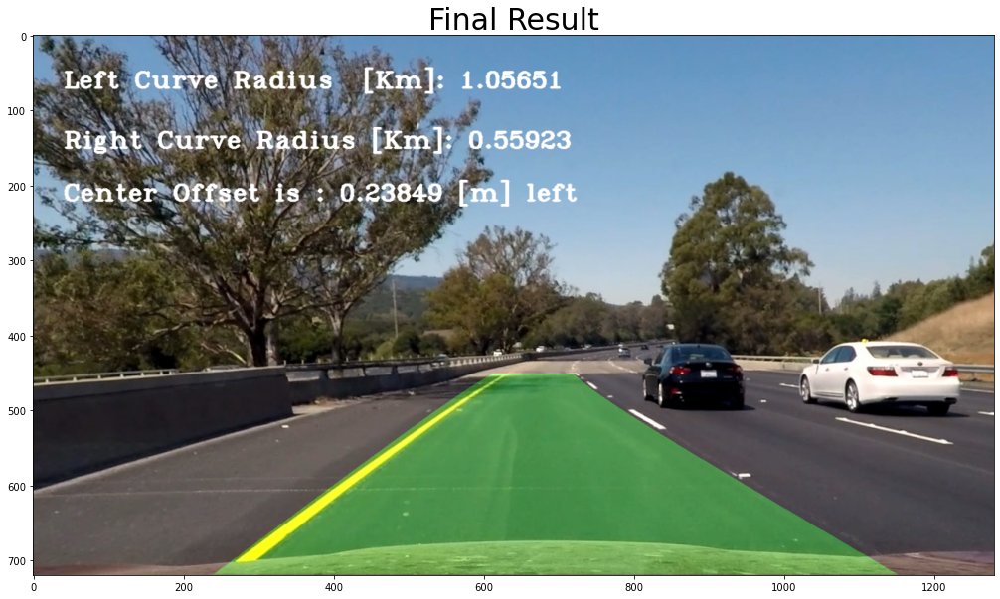

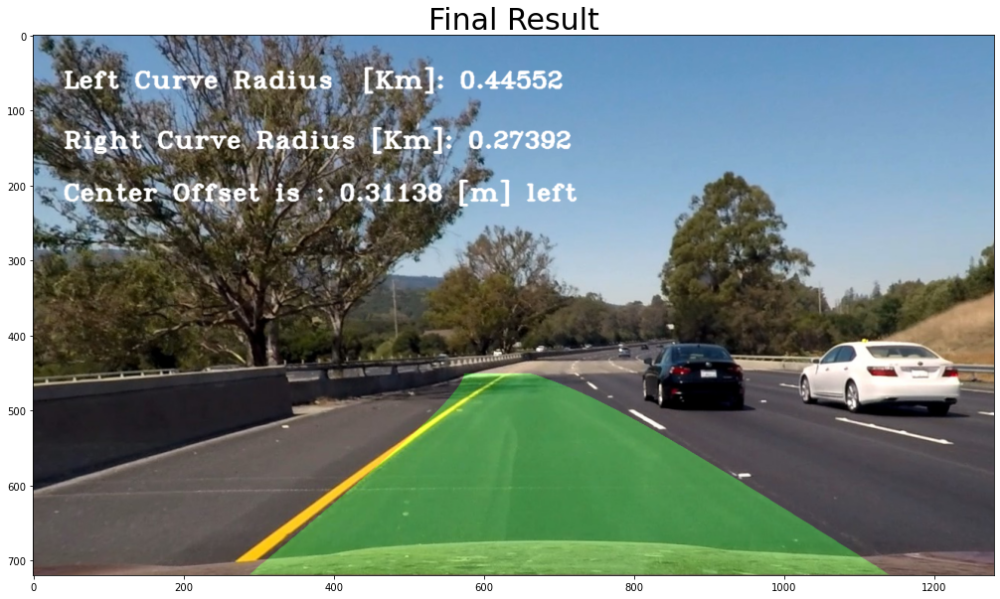

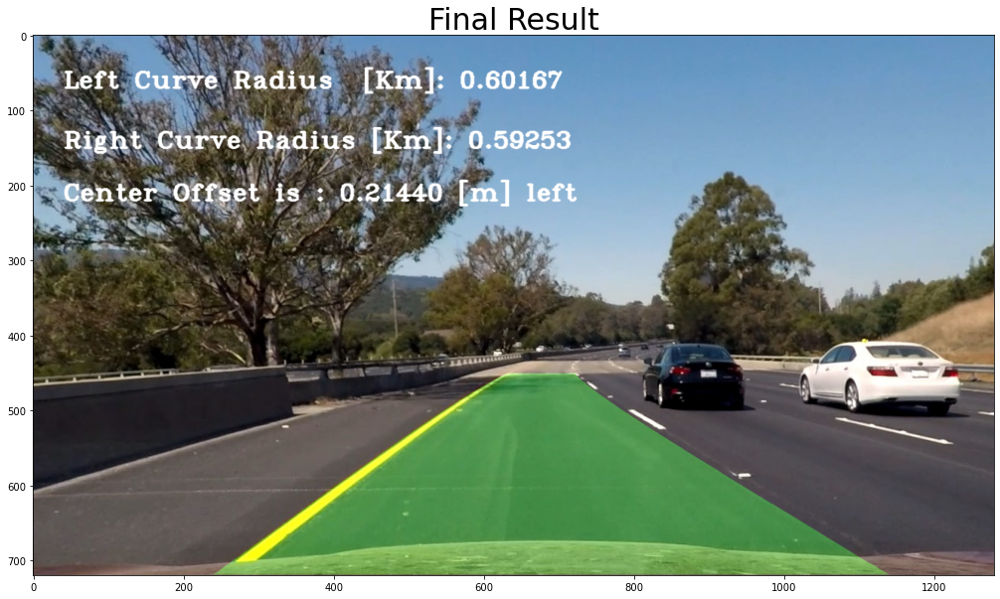

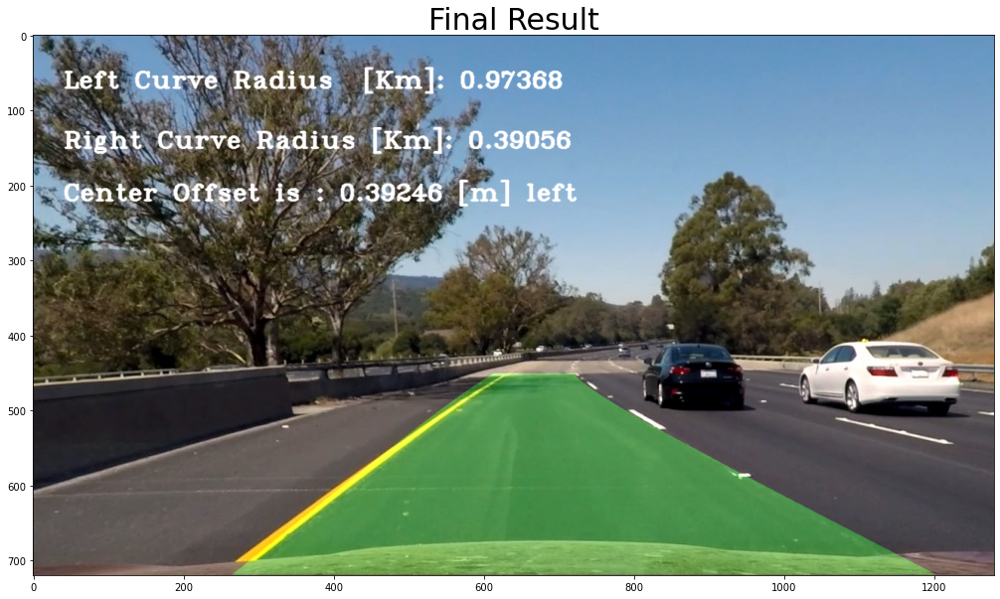

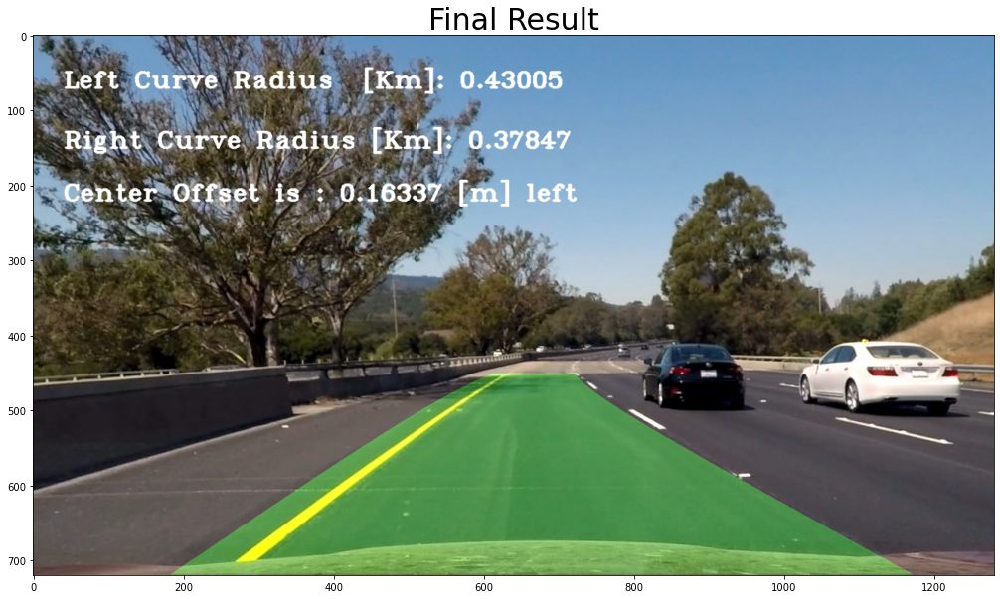

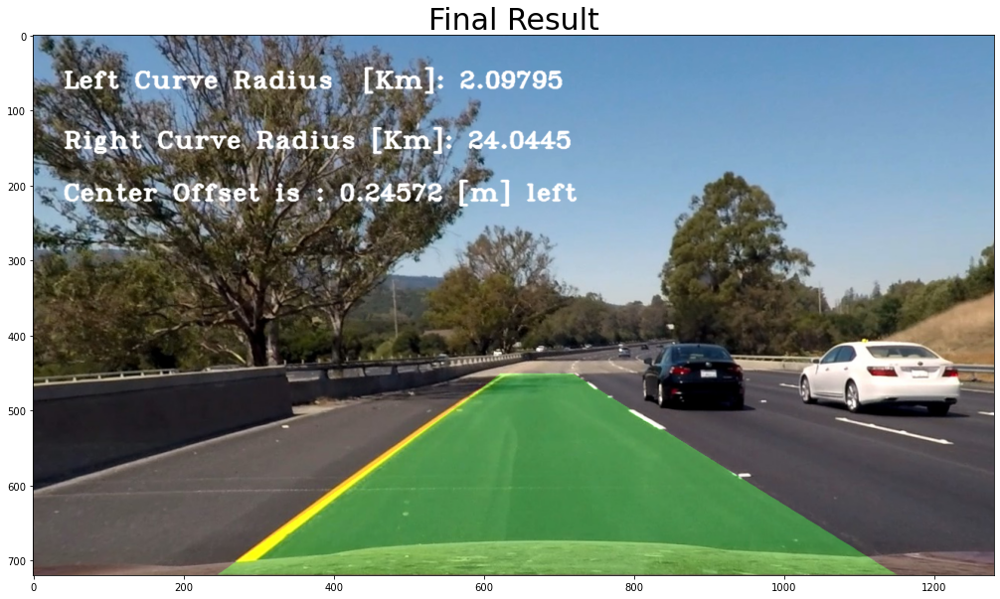

In [59]:

for compined_binary in compined_binary_imgs:

    warped,Minv = Bird_eye_view(compined_binary)

    out_img ,left_fitx , right_fitx,ploty = fit_polynomial(warped)
    
    left_curverad, right_curverad = curvature_estimation(left_fitx,right_fitx,ploty)
    
    offset = position_estimation(warped,left_fitx,right_fitx)
    
    result = draw(undistorted,warped,left_fitx,right_fitx,ploty,Minv,left_curverad,right_curverad,offset)
    
    f, ax1 = plt.subplots(1, 1, figsize=(20,10))
    ax1.imshow(result)
    ax1.set_title('Final Result', fontsize=30)   
    
    
    
    #plt.title("Final Result")
    #plt.imshow(result)
    #plt.show()    
# saving images on hard for review
plt.savefig('output_images/Final_result_sample_output.png')        

# Creating Pipeline as a function and apply it on Video

In [60]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [61]:

def Pipeline(frame):

    undistorted = undistort_img(frame,mtx,dist)
    
    color_threshold = color_thresholding(undistorted)

    sobel_x = gradient_threshold(undistorted,20,75)

    sobel_y = gradient_threshold(undistorted,'y',50,150)

    sobel_mag = mag_thresh(undistorted,sobel_kernel=5, mag_thresh=(40, 150))

    sobel_dir = dir_threshold(undistorted, sobel_kernel=15, thresh=(0.5, 1.3962))

    combined = generate_threshold_compination(sobel_x,sobel_y,sobel_mag,sobel_dir)

    compined_binary = generate_binary_compined(color_threshold,combined)

    warped,Minv = Bird_eye_view(compined_binary)

    out_img ,left_fitx , right_fitx,ploty = fit_polynomial(warped)
    
    left_curverad, right_curverad = curvature_estimation(left_fitx,right_fitx,ploty)
    
    offset = position_estimation(warped,left_fitx,right_fitx)
    
    result = draw(undistorted,warped,left_fitx,right_fitx,ploty,Minv,left_curverad,right_curverad,offset)
    
    return result

In [62]:
video_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
output_clip = clip1.fl_image(Pipeline)
%time output_clip.write_videofile(video_output, audio=False)

t:   0%|                                                                            | 0/1260 [00:00<?, ?it/s, now=None]

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4
Wall time: 8min 10s


In [63]:

HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))